In [1]:
%matplotlib inline
from utils import printSystemInfo

# gVirtualXRay vs Lungman CT

**Main contributors:** J. Pointon, J. Tugwell-Allsup and F. P. Vidal

**Purpose:** In this notebook, we demonstrate how to gVirtualXray can be used to generate CT data from polygon meshes.

**Material and Methods:** For this experiment, we attempt to recreate a CT volume from X-ray projections of the [Lungman chest phantom](https://www.kyotokagaku.com/en/products_data/ph-1_01/) simulated with gVirtualXRay. 

![Photogram of the Lungman phantom](lungman_data/lungman.png)


1. A CT scan acquisition (a set of 2D X-ray projections) is simulated. 
2. Using a CT reconstruction algorithm, we generate the corresponding CT volume.
3. The raw data in linear attenuation coefficients is then converted into Hounsfield units.
4. It allows us to directly compare the CT slices reconstructed from simulated projections with the original CT data.


![Workflow of this study.](./doc/lungman-validation-CT-flow.png)

**Results:** CT slices reconstructed from data simulated with gVirtualXray are visually similar to the original CT images acquired with a clinically utilised device. ZNCC is 98.96%, 98.44% and 99.04% for the images below. MAPE is 5.52%, 5.08% and 4.52%. The absolute error maps show that the errors are concentrated on the boundary of anatomical structures, which explains why SSIM is 0.62, 0.78 and 0.83. The reasons for the discrepencies are:

1. The difficulty to locate the boundary between anatomical structures.
2. The difficulty to segment structures that are highly inhomogeneous such as bones.

Diagonal profiles also show that photonic noise is present in the original data. 

![](./3-output_data/CT_slices.png)

The calculations were performed on the following platform:

In [2]:
printSystemInfo()

OS:
	Linux 5.3.18-150300.59.54-default
	x86_64

CPU:
 	AMD Ryzen 7 3800XT 8-Core Processor

RAM:
	63 GB
GPU:
	Name: NVIDIA GeForce RTX 2080 Ti
	Drivers: 525.60.13
	Video memory: 11 GB


# Import packages

In [3]:
import os, math
import numpy as np
from pathlib import Path
from tifffile import imwrite # Write TIFF file
import datetime

import base64
from IPython.display import Image, display
import json

import SimpleITK as sitk


import matplotlib
import matplotlib.pyplot as plt # Plotting

font = {'family' : 'serif',
        #'weight' : 'bold',
         'size'   : 12.5
       }
matplotlib.rc('font', **font)
# matplotlib.rc('text', usetex=True)

from skimage.metrics import structural_similarity as ssim
from sklearn.metrics import mean_absolute_percentage_error as mape

from gvxrPython3 import gvxr, json2gvxr
from gvxrPython3.utils import visualise
#from gvxrPython3.utils import loadXpecgenSpectrum, loadSpekpySpectrum, has_xpecgen, has_spekpy
from gvxrPython3.JSON2gVXRDataReader import *

from utils import * # Code shared across more than one notebook

from cil.utilities.jupyter import islicer
from cil.processors import TransmissionAbsorptionConverter
from cil.utilities.display import show_geometry, show2D
from cil.recon import FBP, FDK

astropy module not found


SimpleGVXR 2.0.4 (2023-01-18T09:50:01) [Compiler: GNU g++] on Linux
gVirtualXRay core library (gvxr) 2.0.4 (2023-01-18T09:50:00) [Compiler: GNU g++] on Linux


In [4]:
# json2gvxr.has_xpecgen = False

# Some useful functions

**Save the current gVirtualXRay configuration to file**

In [5]:
def saveJSON(fname):
    with open(fname, "w") as outfile:
        json.dump(json2gvxr.params, outfile, indent = 4)

**Perform scan with gVirtualXRay**

In [6]:
def runScan():
    
    # Get the path where the projections are
    # output_path = json2gvxr.getFilePath(json2gvxr.params["Scan"]["OutFolder"])
    output_projection_path = json2gvxr.params["Scan"]["OutFolder"]

    if not os.path.exists(output_projection_path):
        os.makedirs(output_projection_path)

    # Simulate the projections
    angles = json2gvxr.doCTScan(verbose=False)

    # Save angles to file
    with open(output_path + "/angles.csv", "w") as f:
        f.writelines([ f"{x}\n" for x in angles])    

**Save CT reconstruction to file**

In [7]:
def saveReconstruction(fname, reconstruction):
    image = sitk.GetImageFromArray(reconstruction.as_array())
    # image.SetOrigin((0, 0, 0))
    image.SetSpacing([pixel_spacing[0], pixel_spacing[0], pixel_spacing[1]])
    writer = sitk.ImageFileWriter()
    writer.SetFileName(fname)
    writer.UseCompressionOn()
    writer.Execute(image)    

**Perform reconstruction using a gVirtualXRay configuration file**

In [8]:
def reconstruct(JSON_fname):
    
    reader = JSON2gVXRDataReader(file_name=JSON_fname)
    data = reader.read()

    data.reorder(order='tigre')
    data_corr = TransmissionAbsorptionConverter(white_level=data.max())(data)

    ig = data.geometry.get_ImageGeometry()

    ig.voxel_num_x = ref_size[0]
    ig.voxel_num_y = ref_size[1]
    ig.voxel_num_z = ref_size[2]

    source_shape = json2gvxr.params["Source"]["Shape"]

    if type(source_shape) == str:

        if source_shape.upper() == "PARALLELBEAM" or source_shape.upper() == "PARALLEL":
            reconstruction = FBP(data_corr, ig).run()

        elif source_shape.upper() == "POINTSOURCE" or source_shape.upper() == "POINT" or source_shape.upper() == "CONE" or source_shape.upper() == "CONEBEAM":
            reconstruction = FDK(data_corr, ig).run()

        else:
            raise ValueError("Unknown source shape:" + source_shape)

    elif type(source_shape) == type([]):
        if source_shape[0].upper() == "FOCALSPOT":
            reconstruction = FDK(data_corr, ig).run()

        else:
            raise ValueError("Unknown source shape:" + source_shape)

    else:
        raise ValueError("Unknown source shape:" + source_shape)    
        
    return data, reconstruction

**Add a cube of air around the phantom**

In [9]:
output_path = "3-output_data/"

if not os.path.exists(output_path):
    os.mkdir(output_path)

# Read the ground truth Lungman CT data

The data is store in DICOM files. The first slice is loaded manually to extract the metadata. The volume is loaded as a DICOM series.

In [10]:
# A file name that belongs to the series we want to read
file_name = 'lungman_data/CT/DICOM/ST000000/SE000000/CT000000'
data_directory = 'lungman_data/CT/DICOM/ST000000/SE000000'

# Read the file's meta-information without reading bulk pixel data
file_reader = sitk.ImageFileReader()
file_reader.SetFileName(file_name)
file_reader.ReadImageInformation()
file_reader.LoadPrivateTagsOn()
temp_image = file_reader.Execute()

# Get the sorted file names, opens all files in the directory and reads the meta-information
# without reading the bulk pixel data
series_ID = file_reader.GetMetaData('0020|000e')
sorted_file_names = sitk.ImageSeriesReader.GetGDCMSeriesFileNames(data_directory, series_ID)

# Read the bulk pixel data
ref_volume = sitk.ReadImage(sorted_file_names)
real_CT_in_HU = sitk.GetArrayFromImage(ref_volume)

# Extract experiment parameters from the DICOM metadata

"Slice thickness" is calculated from the positions of two neighbouring slices.

In [11]:
kvp = int(temp_image.GetMetaData("0018|0060"))
exposure_time = int(temp_image.GetMetaData("0018|1150"))
xray_tube_current = int(temp_image.GetMetaData("0018|1151"))
exposure = int(temp_image.GetMetaData("0018|1152"))
distance_source_to_detector = float(temp_image.GetMetaData("0018|1110"))
distance_source_to_patient = float(temp_image.GetMetaData("0018|1111"))
pixel_spacing = np.array(file_reader.GetMetaData("0028|0030").split("\\")).astype(np.single).tolist()
ref_size = ref_volume.GetSize()
rows = int(temp_image.GetMetaData("0028|0010"))
columns = int(temp_image.GetMetaData("0028|0011"))
slice_thickness = float(temp_image.GetMetaData("0018|0050"))

print("kVp:", kvp)
print("Exposure time (in msec):", exposure_time)
print("X-ray Tube Current (in mA):", xray_tube_current)
print("Exposure (in mAs):", exposure)
print("Distance Source to Detector (in mm):", distance_source_to_detector)
print("Distance Source to Patient (in mm):", distance_source_to_patient)
print("Pixel Spacing (in mm): ", pixel_spacing)
print("Slice Thickness (in mm): ", slice_thickness)
print("Volume size (in px): ", str(ref_size[0]) + "x" + str(ref_size[1]) + "x" + str(ref_size[2]))

slice_thickness = ref_volume.GetSpacing()[2]
print("Corrected slice Thickness (in mm): ", slice_thickness)

kVp: 100
Exposure time (in msec): 285
X-ray Tube Current (in mA): 128
Exposure (in mAs): 60
Distance Source to Detector (in mm): 1085.6
Distance Source to Patient (in mm): 595.0
Pixel Spacing (in mm):  [0.625, 0.625]
Slice Thickness (in mm):  1.0
Volume size (in px):  512x512x426
Corrected slice Thickness (in mm):  0.7


In [12]:
JSON_fname = "notebook-3.json"
file_abs_path = os.path.abspath(JSON_fname)
dir_path = os.path.dirname(file_abs_path)

**Calculate the diagonal to make the detector size big enough to fit the scan**

In [13]:
diagonal = 1 + round(math.sqrt(math.pow(columns * pixel_spacing[0], 2) + math.pow(rows * pixel_spacing[1], 2)) / pixel_spacing[0])

if diagonal % 2 == 0:
    diagonal + 1

# Initialise gVirtualXRay parameters from a configuration file
Information extracted from the DICOM metadata populates scan parameters here.

In [14]:
json2gvxr.initGVXR(JSON_fname, "OPENGL")


json2gvxr.params["Detector"]["Position"] = [0, -50, 0, "cm"]
json2gvxr.params["Detector"]["UpVector"] =  [0, 0, -1]
json2gvxr.params["Detector"]["NumberOfPixels"] = [diagonal, ref_size[2]]
json2gvxr.params["Detector"]["Spacing"] = [pixel_spacing[0], slice_thickness, "mm"]

json2gvxr.initDetector()


json2gvxr.params["Source"]["Position"] = [0, 50, 0, "cm"]
json2gvxr.params["Source"]["Shape"] = "Parallel"

json2gvxr.initSourceGeometry()

json2gvxr.params["Source"]["Beam"] = {}
json2gvxr.params["Source"]["Beam"]["kvp"] = kvp
json2gvxr.params["Source"]["Beam"]["tube angle"] = 12
json2gvxr.params["Source"]["Beam"]["filter"] = [["Al", 2.5], ["Cu", 0.5]]

# Create a spectrum from the beam parameters 
spectrum =json2gvxr.initSpectrum(verbose=0);

Create an OpenGL context: 450x450
Set up the detector
	Detector position: [0, -50, 0, 'cm']
	Detector up vector: [0, 0, -1]
	Number of pixels: [725, 426]
	Detector number of pixels: [725, 426]
	Pixel spacing: [0.625, 0.7, 'mm']
Set up the beam
	Source position: [0, 50, 0, 'cm']
	Source shape: Parallel


Thu Jan 26 21:00:09 2023 ---- Create window (ID: -1)
Thu Jan 26 21:00:09 2023 ---- Initialise GLFW
Thu Jan 26 21:00:09 2023 ---- Create an OpenGL window with a 3.2 context.
Thu Jan 26 21:00:09 2023 ---- Make the window's context current
Thu Jan 26 21:00:09 2023 ---- Initialise GLEW
Thu Jan 26 21:00:09 2023 ---- OpenGL vendor: NVIDIA Corporation
Thu Jan 26 21:00:09 2023 ---- OpenGL renderer: NVIDIA GeForce RTX 2080 Ti/PCIe/SSE2
Thu Jan 26 21:00:09 2023 ---- OpenGL version: 3.2.0 NVIDIA 525.60.13
Thu Jan 26 21:00:09 2023 ---- Use OpenGL 4.5.
Thu Jan 26 21:00:09 2023 ---- Initialise the X-ray renderer if needed and if possible
Thu Jan 26 21:00:12 2023 ---- Initialise the renderer


**Plot the beam spectrum computed from beam parameters**

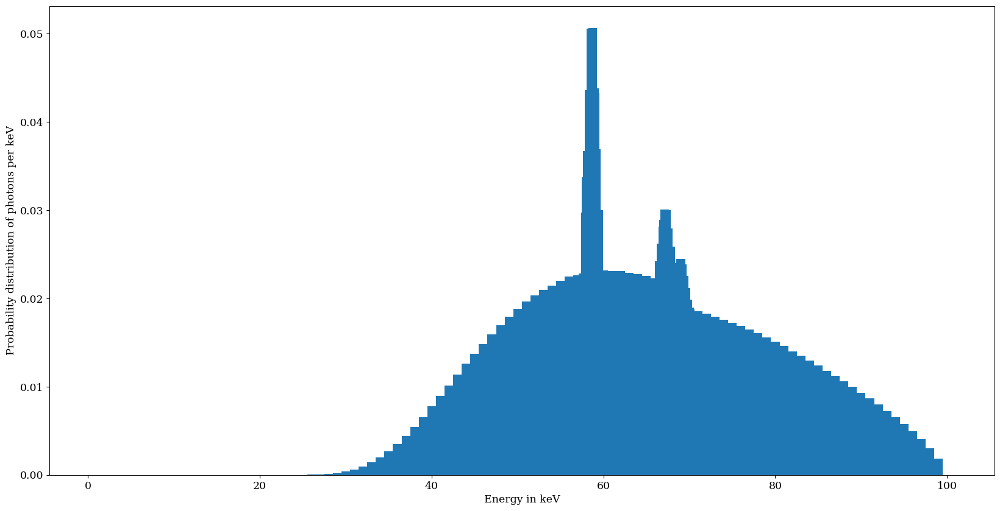

In [15]:
plt.figure(figsize= (20,10))
plt.bar(spectrum[2], spectrum[3], width=1)
plt.xlabel('Energy in keV')
plt.ylabel('Probability distribution of photons per keV')
plt.savefig(output_path + "/lungman-CT-spectrum.pdf")

# Calculate the $\mu$ of water for this scan configuration
- A simple cube composed of water is added to the scene.



- Once a scan is completed the average mu of the structure is used for the conversion from MU to HU.



- The mu of air is assumed to be very close to zero.


The HU conversion is computed by the formula:
$$ HU = 1000 \times \frac{\mu - \mu_{water}}{\mu_{water} - \mu_{air}} $$

First we extract some parameters about the CT scan from the JSON file and create the directory where to store the X-ray projections.

In [16]:
projection_path = json2gvxr.params["Scan"]["OutFolder"]

if not os.path.exists(projection_path):
    os.mkdir(projection_path)

number_of_projections = int(json2gvxr.params["Scan"]["NumberOfProjections"])
final_angle = int(json2gvxr.params["Scan"]["FinalAngle"])

if bool(json2gvxr.params["Scan"]["NumberOfProjections"]):
    step = final_angle / number_of_projections
else:
    step = final_angle / (number_of_projections - 1)

If the scan already exists, load it to save time. If not, create the simulated X-ray projections and perform a reconstruction.

In [17]:
temp_JSON_fname = "temp.json"
fname = output_path + "/CT_water_in_mu.mha"

if os.path.exists(fname):
    sitk_image = sitk.ReadImage(fname)
    temp_CT = sitk.GetArrayFromImage(sitk_image)
    del sitk_image
    
else:
    gvxr.makeCube("water", 10, "cm")
    gvxr.setCompound("water", "H2O")
    gvxr.setDensity("water", 1.0, "g/cm3")
    gvxr.addPolygonMeshAsInnerSurface("water")
    
    json2gvxr.initScan()
    
    projection_set = gvxr.computeProjectionSet(0, 0, 0, "cm", number_of_projections, step)
    projection_set = np.array(projection_set, dtype='float32')

    for i, projection in enumerate(projection_set):
        imwrite(projection_path + "/projection-" + str(i).zfill(4) + ".tif", projection)
        
    saveJSON(temp_JSON_fname)
    
    data, reconstruction = reconstruct(temp_JSON_fname)
    
    saveReconstruction(fname, reconstruction)
    temp_CT = reconstruction.as_array()
    
    del data
    del reconstruction

**Extract the mean from a region of interest (inside the cube)**

This value will be used as the $\mu$ of water to convert the final CT scan in Hounsfied Units.

In [18]:
cube_length = 180
x_min = 0 + cube_length
y_min = 0 + cube_length
z_min = 142

x_max = 512 - cube_length - 1
y_max = 512 - cube_length - 1
z_max = 282 - 1

water_box_mu = temp_CT[z_min:z_max, y_min:y_max, x_min:x_max]
mu_water = np.mean(water_box_mu)

del temp_CT
del water_box_mu

**Add the lungman meshes to the scene graph**


SID (source-imager distance) and SOD (source-object distance) have been extracted from the DICOM metadata.

In [19]:
json2gvxr.initSamples()

skin_bbox = gvxr.getNodeOnlyBoundingBox("Skin", "mm")

json2gvxr.params["Detector"]["Position"] = [0, 
                                            (skin_bbox[1] + distance_source_to_patient - distance_source_to_detector), 
                                            0, 
                                            "mm"]
json2gvxr.initDetector()



json2gvxr.params["Source"]["Position"] = [0, 
                                          (distance_source_to_detector + skin_bbox[1] + distance_source_to_patient - distance_source_to_detector), 
                                          0, 
                                          "mm"]

Thu Jan 26 21:00:15 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/bronchioles.stl	nb_faces:	5338192	nb_vertices:	

Set up the detector
	Detector position: [0, -608.0999999999999, 0, 'mm']
	Detector up vector: [0, 0, -1]
	Number of pixels: [725, 426]
	Detector number of pixels: [725, 426]
	Pixel spacing: [0.625, 0.7, 'mm']


16014576	bounding_box (in cm):	(-12.625, -8.3125, -13.65)	(11.8125, 7.3125, 12.81)
Thu Jan 26 21:00:15 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/bronchus.stl	nb_faces:	701200	nb_vertices:	2103600	bounding_box (in cm):	(-11.375, -8.0625, -11.97)	(11.75, 6.5, 10.57)
Thu Jan 26 21:00:15 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/trachea.stl	nb_faces:	88328	nb_vertices:	264984	bounding_box (in cm):	(-2.8125, -6.625, -1.68)	(3.8125, 0.5, 14.84)
Thu Jan 26 21:00:15 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/diaphram.stl	nb_faces:	507436	nb_vertices:	1522308	bounding_box (in cm):	(-12.625, -9, -14.84)	(11.875, 6.3125, -8.26)
Thu Jan 26 21:00:16 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/skin.stl	nb_faces:	6422456	nb_vertices:	19267368	bounding_box (in cm):	(-15.9375, -11.75, -14.84)	(15.9375, 10.75, 14.84)
Thu 

Compute the number of triangles.

In [20]:
number_of_triangles = 0

for sample in json2gvxr.params["Samples"]:
    label = sample["Label"]
    number_of_triangles_in_mesh = gvxr.getNumberOfPrimitives(label)
    number_of_triangles += number_of_triangles_in_mesh
    
print("There are", f"{number_of_triangles:,}", "triangles in total")

There are 23,722,716 triangles in total


**Initialise the scan with the lungman**

In [21]:
json2gvxr.initScan()
gvxr.computeXRayImage()
gvxr.displayScene()

Set up the CT Scan


**Do a k3d plot of the scene**

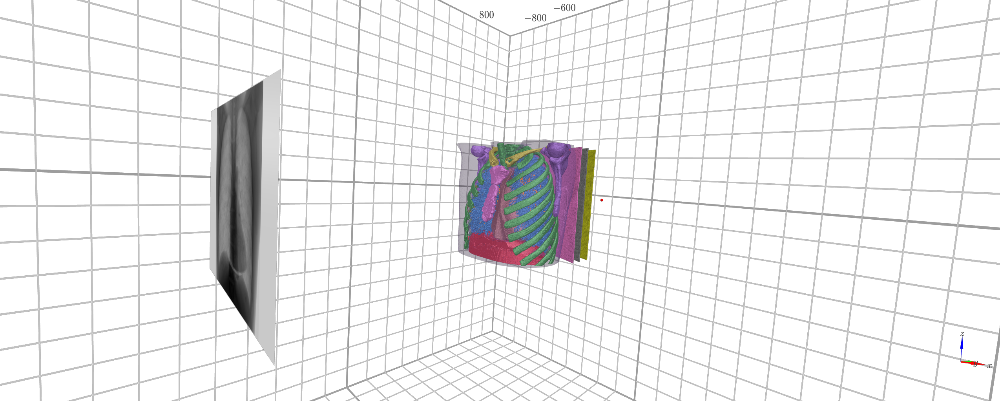

In [22]:
fname = output_path + "/visualisation.png"

if os.path.exists(fname):
    display(Image(fname, width=1000))
else:
    plot = visualise(use_log=True)
    plot.display()

In [23]:
if not os.path.exists(fname):
    if plot is not None:
        plot.fetch_screenshot()

        data = base64.b64decode(plot.screenshot)
        with open(fname,'wb') as fp:
            fp.write(data)

**Perform CT acquisition on the lungman**

It might take a bit long because the 3D visualisation is turned on. We can speed the simulation up by disabling the 3D visualisation. To further speed up the simulation, the C++ API (`gvxr.computeProjectionSet`) can be used instead of the simplified JSON API (`runScan()`).

In [24]:
# runScan()

In [25]:
start_time = datetime.datetime.now()
projection_set = gvxr.computeProjectionSet(0, 0, 0, "cm", number_of_projections, step)
end_time = datetime.datetime.now()
delta_time = end_time - start_time
run_time_in_msec_per_frame = delta_time.total_seconds() * 1000 / number_of_projections

In [26]:
# Save the projections
projection_set = np.array(projection_set, dtype='float32')
    
for i, projection in enumerate(projection_set):
    imwrite(projection_path + "/projection-" + str(i).zfill(4) + ".tif", projection)

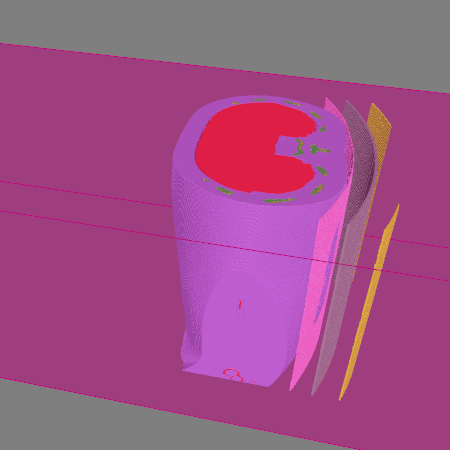

In [27]:
# gif_fname = json2gvxr.getFilePath(json2gvxr.params["Scan"]["GifPath"])
if "GifPath" in json2gvxr.params["Scan"]:
    gif_fname = json2gvxr.params["Scan"]["GifPath"]

    with open(gif_fname,'rb') as f:
        display(Image(data=f.read(), format='png', width=1000))

**Reconstruct the CT volume from projection data**

In [28]:
saveJSON(temp_JSON_fname)
data, reconstruction = reconstruct(temp_JSON_fname)
# saveReconstruction(output_path + "/lungman-simulated_CT_in_mu.mha", reconstruction)

[0. 1. 0.]
[  0.  608.1   0. ]
[0, 0, 0]
[ 0  0 -1]
[725, 426]
[0.625, 0.7]
FBP recon

Input Data:
	angle: 1901
	vertical: 426
	horizontal: 725

Reconstruction Volume:
	vertical: 426
	horizontal_y: 512
	horizontal_x: 512

Reconstruction Options:
	Backend: tigre
	Filter: ram-lak
	FFT order: 11
	Filter_inplace: False
	Split processing: 0

Reconstructing in 1 chunk(s):



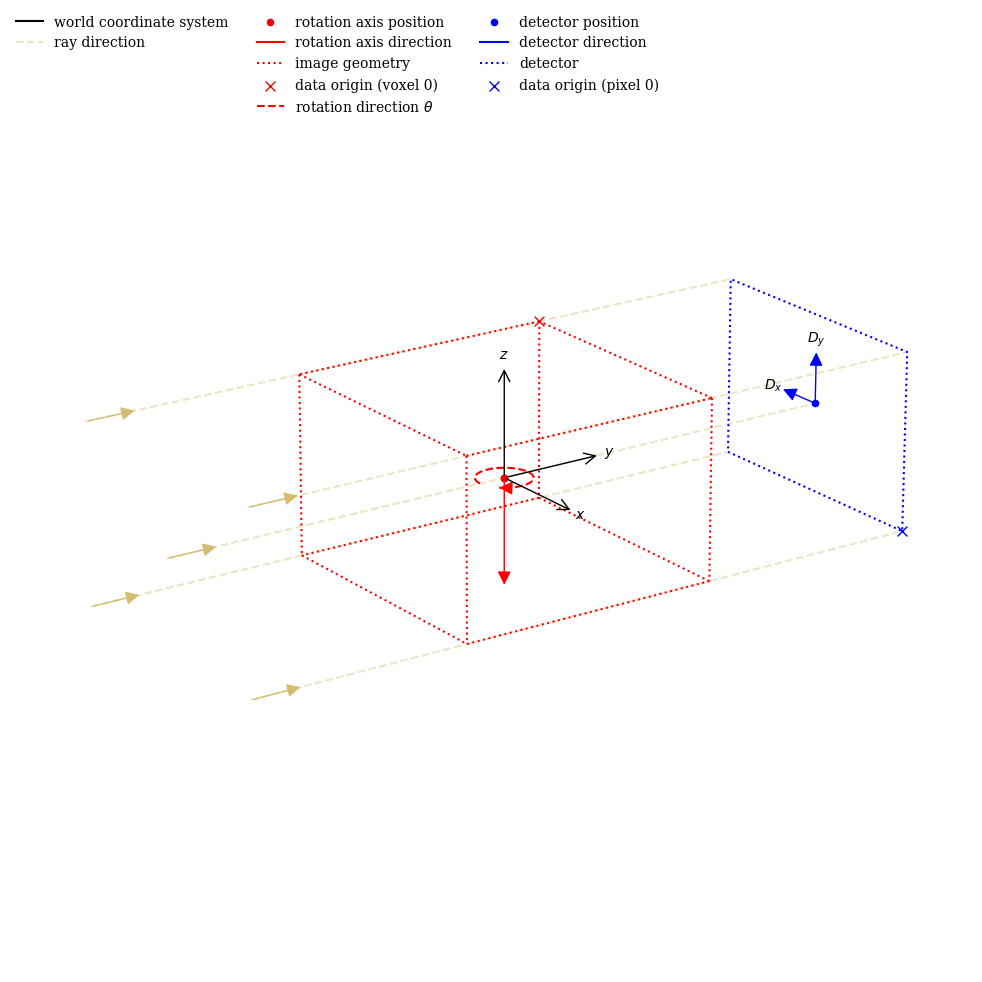

In [29]:
show_geometry(data.geometry)

In [30]:
islicer(reconstruction, direction='vertical')

interactive(children=(IntSlider(value=213, continuous_update=False, description='vertical', max=425), FloatRan…

IntSlider(value=213, continuous_update=False, description='vertical', max=425)

In [31]:
islicer(reconstruction, direction='horizontal_x')

interactive(children=(IntSlider(value=256, continuous_update=False, description='horizontal_x', max=511), Floa…

IntSlider(value=256, continuous_update=False, description='horizontal_x', max=511)

**Convert the CT voxel data from $\mu$ to houndsfield units**

In [32]:
mu_air = 0
simulated_CT_in_HU = np.array(1000 * (reconstruction.as_array() - mu_water) / (mu_water - mu_air), dtype=np.int16)

In [33]:
fname = output_path + "/lungman-simulated_CT_in_HU.mha"

if True:#not os.path.exists(fname):
    
    sitk_image = sitk.GetImageFromArray(simulated_CT_in_HU)
    sitk_image.SetSpacing([pixel_spacing[0], pixel_spacing[0], slice_thickness])
    sitk.WriteImage(sitk_image, fname, useCompression=True)
    
    del sitk_image

In [34]:
flipped_volume = np.flip(simulated_CT_in_HU, axis=2)

**Calculate metrics between the ground truth CT and the simulated one**

In [35]:
slice_id = real_CT_in_HU.shape[0] // 2
# slice_id = 403
# last_row = 400

first_slice_ref = real_CT_in_HU[1].astype(float)
first_slice_test = flipped_volume[1].astype(float)

MAPE_0 = mape(first_slice_ref + np.min(real_CT_in_HU) + 1, first_slice_test + np.min(real_CT_in_HU) + 1)
ZNCC_0 = np.mean((first_slice_ref - first_slice_ref.mean()) / first_slice_ref.std() * (first_slice_test - first_slice_test.mean()) / first_slice_test.std())
SSIM_0 = ssim(first_slice_ref, first_slice_test, data_range=first_slice_ref.max() - first_slice_ref.min())

print("First slice")
print("MAPE:", "{0:0.2f}".format(100 * MAPE_0) + "%")
print("ZNCC:", "{0:0.2f}".format(100 * ZNCC_0) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM_0))
print()



middle_slice_ref = real_CT_in_HU[slice_id].astype(float)
middle_slice_test = flipped_volume[slice_id].astype(float)

MAPE_1 = mape(middle_slice_ref + np.min(real_CT_in_HU) + 1, middle_slice_test + np.min(real_CT_in_HU) + 1)
ZNCC_1 = np.mean((middle_slice_ref - middle_slice_ref.mean()) / middle_slice_ref.std() * (middle_slice_test - middle_slice_test.mean()) / middle_slice_test.std())
SSIM_1 = ssim(middle_slice_ref, middle_slice_test, data_range=middle_slice_ref.max() - middle_slice_ref.min())

print("Middle slice")
print("MAPE:", "{0:0.2f}".format(100 * MAPE_1) + "%")
print("ZNCC:", "{0:0.2f}".format(100 * ZNCC_1) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM_1))
print()


last_slice_ref = real_CT_in_HU[real_CT_in_HU.shape[0] - 2].astype(float)
last_slice_test = flipped_volume[real_CT_in_HU.shape[0] - 2].astype(float)

MAPE_2 = mape(last_slice_ref + np.min(real_CT_in_HU) + 1, last_slice_test + np.min(real_CT_in_HU) + 1)
ZNCC_2 = np.mean((last_slice_ref - last_slice_ref.mean()) / last_slice_ref.std() * (last_slice_test - last_slice_test.mean()) / last_slice_test.std())
SSIM_2 = ssim(last_slice_ref, last_slice_test, data_range=last_slice_ref.max() - last_slice_ref.min())

print("Last slice")
print("MAPE:", "{0:0.2f}".format(100 * MAPE_2) + "%")
print("ZNCC:", "{0:0.2f}".format(100 * ZNCC_2) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM_2))

First slice
MAPE: 5.52%
ZNCC: 98.96%
SSIM: 0.62

Middle slice
MAPE: 5.08%
ZNCC: 98.44%
SSIM: 0.78

Last slice
MAPE: 4.52%
ZNCC: 99.04%
SSIM: 0.83


In [36]:
def plotProfiles(ref, test, fname):
    ground_truth_diag = np.diag(ref)
    gvxr_diag = np.diag(test)

    x = np.linspace(0, len(ground_truth_diag), len(ground_truth_diag)) * pixel_spacing[0]
    plt.figure(figsize=(15, 5))

    ax = plt.subplot(111)

    ax.set_title("Diagonal profiles")

    ax.plot(x, ground_truth_diag, label="Ground truth (real CT)")
    ax.plot(x, gvxr_diag, label="CT reconstructed from data simulated with gVirtualXray")

    ax.legend(loc='best',
              ncol=1, fancybox=True, shadow=True)

    plt.xlabel("Pixel position (in mm)")
    plt.ylabel("Pixel intensity")

    plt.savefig(fname + '.pdf')
    plt.savefig(fname + '.png')

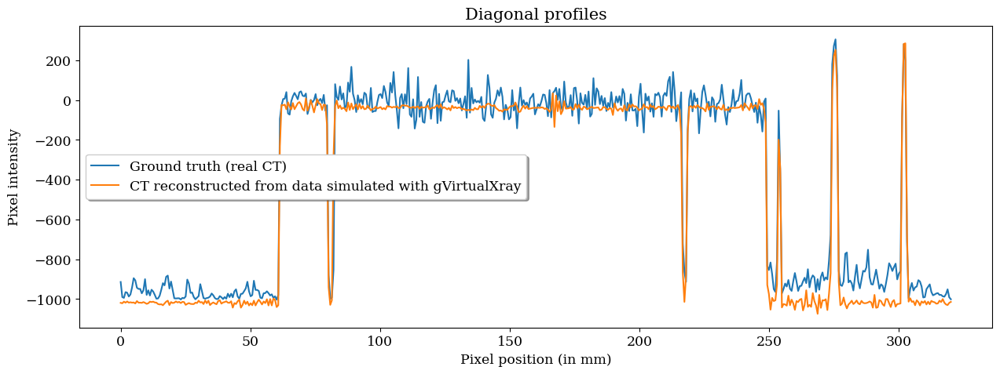

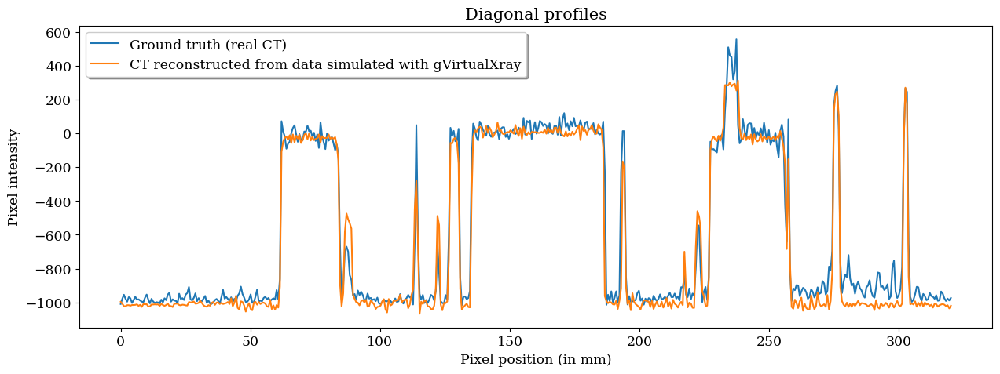

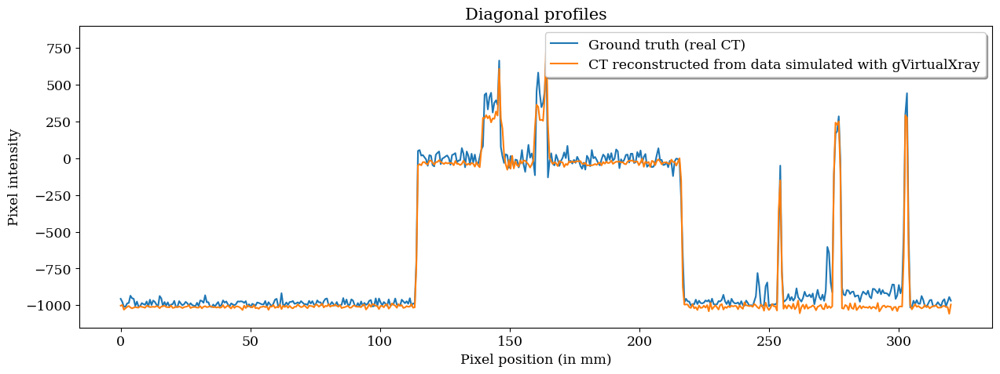

In [37]:
plotProfiles(first_slice_ref,  first_slice_test,  output_path + '/profiles-lungman_CT-first_slice')
plotProfiles(middle_slice_ref, middle_slice_test, output_path + '/profiles-lungman_CT-middle_slice')
plotProfiles(last_slice_ref,   last_slice_test,   output_path + '/profiles-lungman_CT-last_slice')

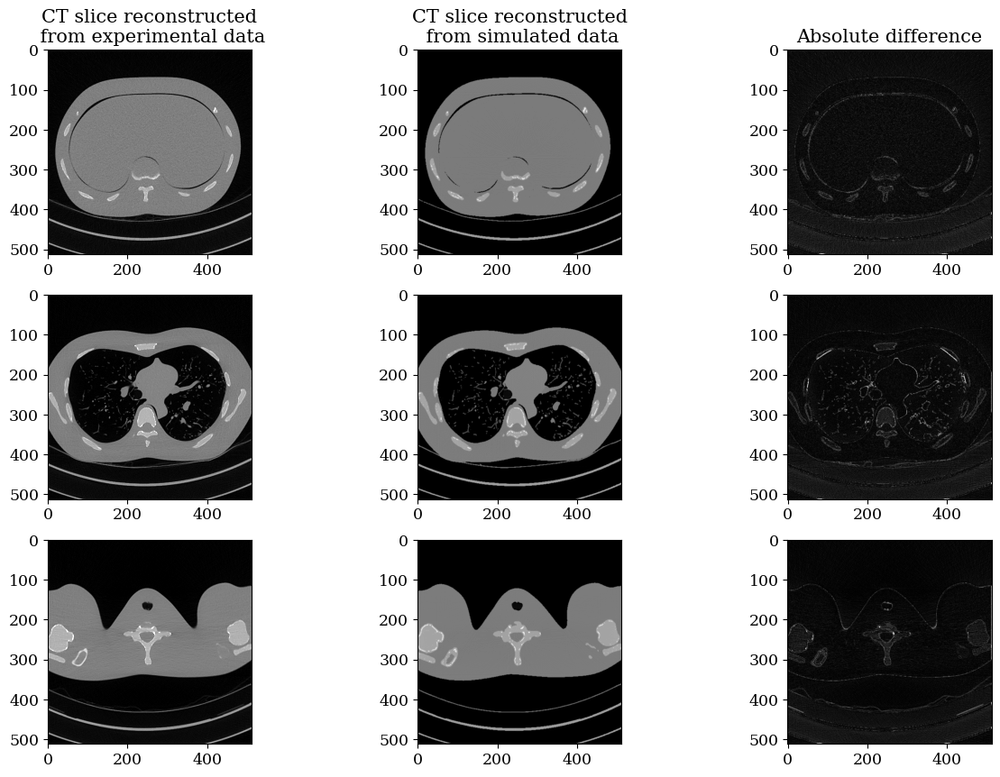

In [38]:
fig, axs = plt.subplots(3, 3, figsize=(15,10))

axs[0,0].imshow(first_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[0,1].imshow(first_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[0,2].imshow(np.abs(first_slice_ref - first_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[1,0].imshow(middle_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[1,1].imshow(middle_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[1,2].imshow(np.abs(middle_slice_ref - middle_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[2,0].imshow(last_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[2,1].imshow(last_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[2,2].imshow(np.abs(last_slice_ref - last_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[0,0].set_title("CT slice reconstructed\n from experimental data")
axs[0,1].set_title("CT slice reconstructed\n from simulated data")
axs[0,2].set_title("Absolute difference")


plt.savefig(output_path + "/CT_slices.png")

In [39]:
gvxr.terminate()

Thu Jan 26 21:03:42 2023 ---- Destroy all the windows
Thu Jan 26 21:03:43 2023 ---- Destroy window 0(0x55c49e7c9430)


In [40]:
os.remove(temp_JSON_fname)


In [41]:
print("(First) Slice reconstructed from simulated data & Original CT  & " + 
      "{0:0.2f}".format(100 * MAPE_0) + "\\%    &    " +
      "{0:0.2f}".format(100 * ZNCC_0) + "\\%    &    " +
      "{0:0.2f}".format(SSIM_0) + "    &    $" +
      str(first_slice_ref.shape[1]) + " \\times " + str(first_slice_ref.shape[0]) + "$    &    " +
      str(number_of_triangles) + "    &    " + "N/A" + "    & " +
      "$" + str(int(run_time_in_msec_per_frame)) + "$ \\\\")

(First) Slice reconstructed from simulated data & Original CT  & 5.52\%    &    98.96\%    &    0.62    &    $512 \times 512$    &    23722716    &    N/A    & $59$ \\


In [42]:
print("(Middle) Slice reconstructed from simulated data & Original CT  & " + 
      "{0:0.2f}".format(100 * MAPE_1) + "\\%    &    " +
      "{0:0.2f}".format(100 * ZNCC_1) + "\\%    &    " +
      "{0:0.2f}".format(SSIM_1) + "    &    $" +
      str(first_slice_ref.shape[1]) + " \\times " + str(first_slice_ref.shape[0]) + "$    &    " +
      str(number_of_triangles) + "    &    " + "N/A" + "    & " +
      "$" + str(int(run_time_in_msec_per_frame)) + "$ \\\\")

(Middle) Slice reconstructed from simulated data & Original CT  & 5.08\%    &    98.44\%    &    0.78    &    $512 \times 512$    &    23722716    &    N/A    & $59$ \\


In [43]:
print("(Last) Slice reconstructed from simulated data & Original CT  & " + 
      "{0:0.2f}".format(100 * MAPE_2) + "\\%    &    " +
      "{0:0.2f}".format(100 * ZNCC_2) + "\\%    &    " +
      "{0:0.2f}".format(SSIM_2) + "    &    $" +
      str(first_slice_ref.shape[1]) + " \\times " + str(first_slice_ref.shape[0]) + "$    &    " +
      str(number_of_triangles) + "    &    " + "N/A" + "    & " +
      "$" + str(int(run_time_in_msec_per_frame)) + "$ \\\\")

(Last) Slice reconstructed from simulated data & Original CT  & 4.52\%    &    99.04\%    &    0.83    &    $512 \times 512$    &    23722716    &    N/A    & $59$ \\
